# Toy Brains Documentation

> Author(s): JiHoon Kim<br>
> Date: 08 May 2023<br>
> Summary: Documentation for
> 1. How to generate the Toy Brains Dataset using `create_shapes_data`.<br>
> 2. What is Generative Variables (GVs) include some example images with different states of each Generative Variable (GV).<br>
> 3. `TBA` ~What is Confounds and Labels with some example images.~

[Toy Brains Dataset](https://github.com/RoshanRane/toybrains) is a synthetic brain MRI, which contain different states of Generative Variables (GVs). Currently, it support 2D images (64 x 64 pixels) as brain MRI slice (2D). The dataset can be used as a baseline toy dataset for either confound analysis, or casuality analysis.

In this documentation,
1. You will understand how to generate the synthetic dataset using [create_shapes_data](../create_shapes_data.py) command.
2. You will discover key concept, GV (currently we have around 20 GVs) with some examples of different states of GVs in Toy Brains Dataset.
3. `TBA` ~You will find confounds, and lables in the context of covariates.~

## Setup notebook
**IPython Magic commands:** <br>
IPython provides some convinient predefined *'magic functions'* as [documented here](https://ipython.readthedocs.io/en/stable/interactive/magics.html). In a jupyter cell, we can use `%` followed by one of the magic function names. This notebook uses 3 commands: <br>
    (a) `%matplotlib inline`:  Sets the backend of matplotlib to the 'inline' backend, therefore all pyplots plots changing how the plots are displayed and stored so that they are inline with the frontend; stored within the notebook document <br>
    (b) `%load_ext autoreload` and `%autoreload 2`: Reloads modules automatically before the execution of code. This is useful if you are making changes in another python file and testing it here. Without this command you will have to restart the notebook everytime.
</font>

In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

## Import python modules

**Tips**:<br>
If you get `unknown module ...` error running the next cell, then it means you need to install that specific python modules in your python environment before you can proceed

In [2]:
# standard python packages

import os
import numpy as np
import pandas as pd
from glob import glob
import matplotlib.pyplot as plt 
from PIL import Image, ImageDraw

Add an parent directory environment path for `create_shapes_data.py`

In [3]:
parent_dir = os.path.abspath('..')
os.chdir(parent_dir)

In [13]:
from visualization import *

## How to generate the synthetic brain MRI

### Arguments
Synthetic brain MRI is generated with the size of 64 X 64 pixels as a default. Currently, you can adjust three arguments: `N_SAMPLES`, `DIR`, `debug` using parser for command-line option.

Each argument information showed in the table below.

|   Name    |  Parser Argument(s) | Description | Default Value | Type |
| :--------- | ---------------- | ----------- |:-----------: | ---- |
| N_SAMPLES | -n , --n_samples | Number of samples | 100 | Integer |
| DIR       | --dir            | Specify the folder which contain outputs | toybrains | String |
| debug | -d , --debug | Run the debug mode | True | Boolean |

You can check the arguments using `-h` command like below

In [5]:
! python create_toybrains.py -h

usage: create_toybrains.py [-h] [-n N_SAMPLES] [--dir DIR] [-d]

optional arguments:
  -h, --help            show this help message and exit
  -n N_SAMPLES, --n_samples N_SAMPLES
  --dir DIR
  -d, --debug


### Generate the synthetic brain MRI
To generate the synthetic Brain MRI dataset, run [create_shapes_data.py](../create_shapes_data.py) with arguments.

`CAUTION`<br>
If folder exists, it overwrites the folder. If you don't want that happens, then you should change the `DIR` name.

Belows are the example command to generate 1000 samples.

In [ ]:
! python create_toybrains.py -n 1000

After running the code, you can find the ouptut in the *DIR* (default `toybrains`). It contain one csv file, and two folders: images, and label.

```
.toybrains
| -- .images
    | ... *.jpg            # Synthetic images are here
| -- .label
| -- toybrains_n100.csv    # You can find all general information in here
```

### Visualize the data

You can find the csv file named `toybrains_n*.csv` in the output `DIR`.

In [6]:
df = pd.read_csv(glob("toybrains/toybrains_n*.csv")[0]).set_index('subjectID')

# sort dataframe cols by column name

df = df.reindex(sorted(df.columns), axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000 entries, 0 to 999
Data columns (total 34 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   _gen_brain_vol-radmajor   1000 non-null   float64
 1   _gen_brain_vol-radminor   1000 non-null   float64
 2   _gen_shape-botl_vol-rad   1000 non-null   float64
 3   _gen_shape-botr_vol-rad   1000 non-null   float64
 4   _gen_shape-midl_vol-rad   1000 non-null   float64
 5   _gen_shape-midr_vol-rad   1000 non-null   float64
 6   _gen_shape-top_vol-rad    1000 non-null   float64
 7   cov_age                   1000 non-null   float64
 8   cov_sex                   1000 non-null   object 
 9   cov_site                  1000 non-null   object 
 10  gen_border_int            1000 non-null   object 
 11  gen_brain_int             1000 non-null   float64
 12  gen_brain_thick           1000 non-null   float64
 13  gen_brain_vol             1000 non-null   float64
 14  gen_shape

You can check the images in the `images` folder in `DIR`. In defuault, it saved as *.jpg with 64 X 64 pixels  resolution.

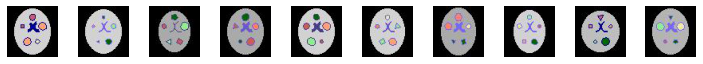

In [10]:
img_files = sorted(glob("toybrains/images/*.jpg"))

show_images(img_files=img_files, n_rows=1)

## Comphresion of Generative Variables (GVs) in Toy Brains Dataset

### Generative Variables (GVs)

In this section, we introduce *<b>Generative Variables (GVs)</b>* of Toy Brains Dataset. It starts with motivation, next definition, and types of GVs.

#### Motivation
TBA by @Roshan : `motivation of Generative variables`

#### Definition
TBA by @Roshan : `definition of Generative variables`

### Distribution of GVs

Currently, we have 20 GVs. Below plot showed the summary of GV's value in 1000 samples, and some dataset.

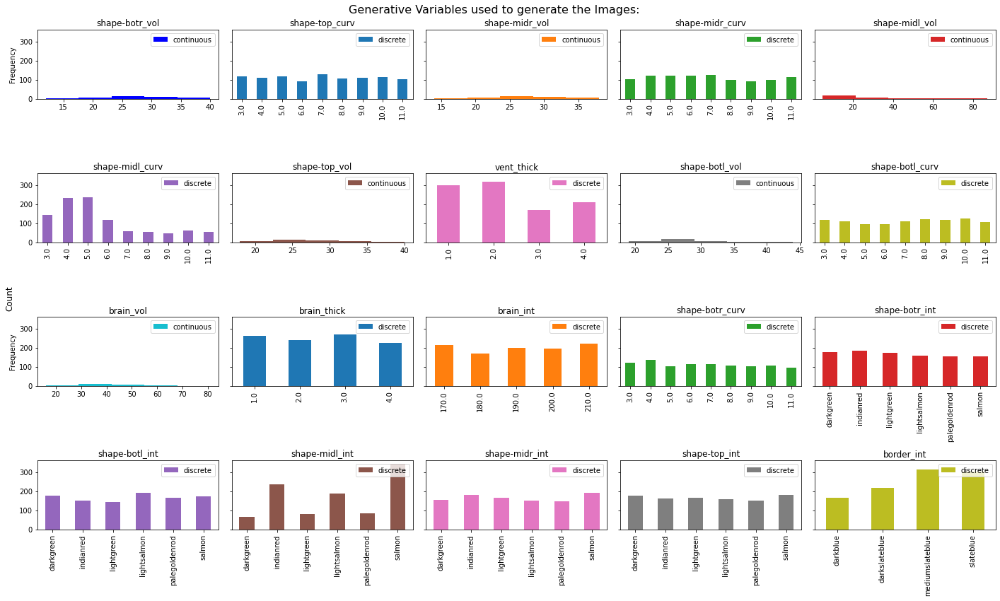

In [16]:
gens = show_table(df)

In [15]:
gens.head(5)

,gen_border_int,gen_brain_int,gen_brain_thick,gen_brain_vol,gen_shape-botl_curv,gen_shape-botl_int,gen_shape-botl_vol,gen_shape-botr_curv,gen_shape-botr_int,gen_shape-botr_vol,gen_shape-midl_curv,gen_shape-midl_int,gen_shape-midl_vol,gen_shape-midr_curv,gen_shape-midr_int,gen_shape-midr_vol,gen_shape-top_curv,gen_shape-top_int,gen_shape-top_vol,gen_vent_thick
subjectID,,,,,,,,,,,,,,,,,,,,
0,darkblue,210.0,4.0,2095.442300,4.0,palegoldenrod,25.455844,8.0,lightsalmon,76.536686,4.0,indianred,25.455844,8.0,lightsalmon,76.536686,9.0,indianred,49.250901,4.0
1,mediumslateblue,210.0,4.0,2023.185669,7.0,darkgreen,48.594979,3.0,darkgreen,10.392305,4.0,salmon,11.313708,10.0,lightgreen,27.811529,11.0,darkgreen,12.396233,2.0
2,darkslateblue,170.0,4.0,1633.628180,4.0,indianred,45.254834,3.0,lightgreen,41.569219,6.0,indianred,27.000000,9.0,lightgreen,76.954532,5.0,darkgreen,47.022820,1.0
3,slateblue,170.0,1.0,2095.442300,10.0,indianred,77.254249,9.0,darkgreen,12.312725,3.0,indianred,41.569219,9.0,salmon,49.250901,11.0,darkgreen,77.476453,4.0
4,darkslateblue,210.0,3.0,2095.442300,8.0,indianred,12.245870,11.0,lightgreen,77.476453,8.0,indianred,48.983479,10.0,lightsalmon,77.254249,9.0,darkgreen,49.250901,4.0


### Image Examples

Below plots show 10 images of different states of each generative variable (GV) from the dataset. 

#### gen_border_int

GV : gen_border_int_darkblue


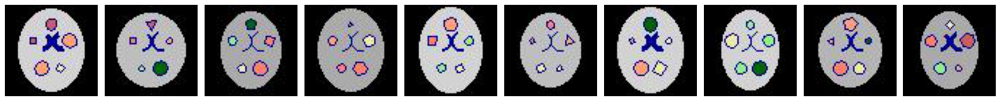

[0, 8, 10, 26, 27, 28, 30, 44, 61, 70]

GV : gen_border_int_mediumslateblue


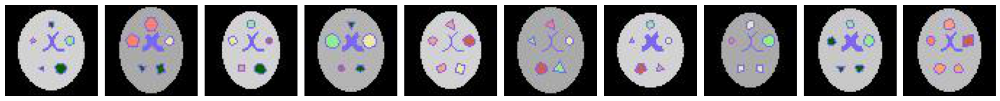

[1, 6, 7, 9, 15, 19, 23, 25, 31, 34]

GV : gen_border_int_darkslateblue


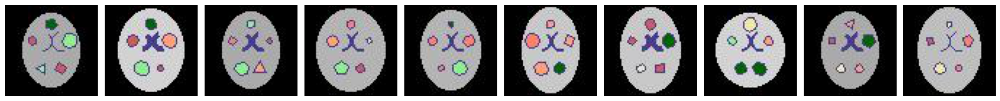

[2, 4, 16, 22, 29, 33, 35, 37, 38, 42]

GV : gen_border_int_slateblue


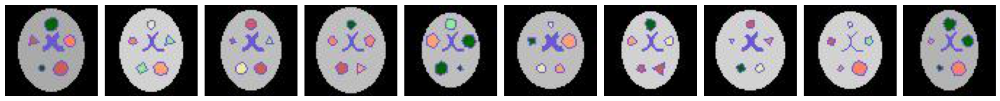

[3, 5, 11, 12, 13, 14, 17, 18, 20, 21]



In [40]:
show_examples(gens, col = 0, DIR = "toybrains", N = 10)

#### gen_brain_int

GV : gen_brain_int_210.0


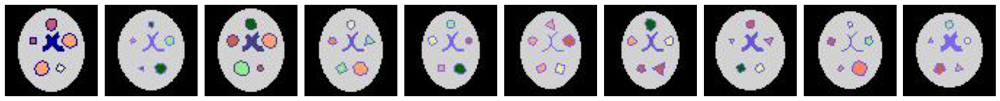

[0, 1, 4, 5, 7, 15, 17, 18, 20, 23]

GV : gen_brain_int_170.0


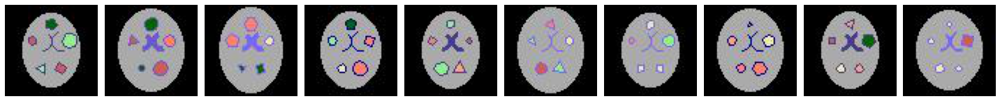

[2, 3, 6, 10, 16, 19, 25, 26, 38, 40]

GV : gen_brain_int_190.0


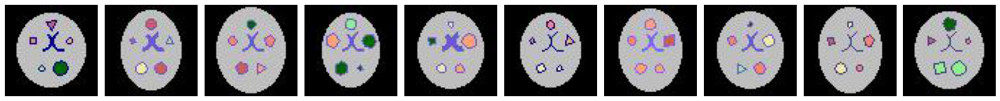

[8, 11, 12, 13, 14, 28, 34, 36, 42, 56]

GV : gen_brain_int_180.0


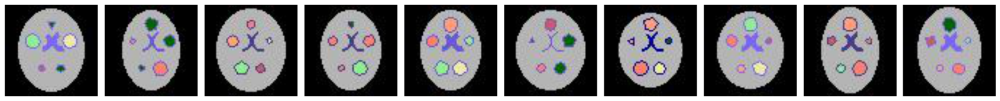

[9, 21, 22, 29, 49, 57, 61, 67, 77, 84]

GV : gen_brain_int_200.0


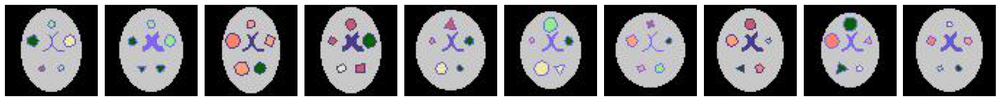

[24, 31, 33, 35, 39, 43, 48, 53, 64, 72]



In [41]:
show_examples(gens, col = 1, DIR = "toybrains", N = 10)

#### gen_brain_thick

GV : gen_brain_thick_4.0


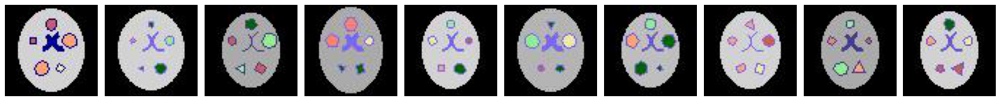

[0, 1, 2, 6, 7, 9, 13, 15, 16, 17]

GV : gen_brain_thick_1.0


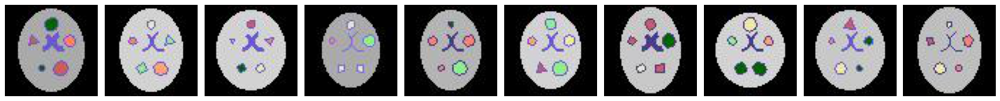

[3, 5, 18, 25, 29, 32, 35, 37, 39, 42]

GV : gen_brain_thick_3.0


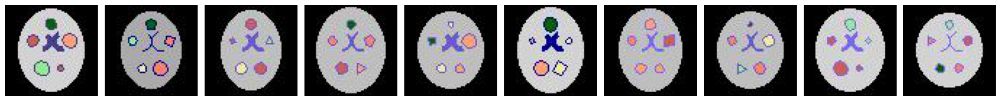

[4, 10, 11, 12, 14, 30, 34, 36, 41, 47]

GV : gen_brain_thick_2.0


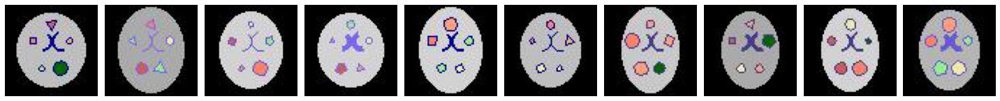

[8, 19, 20, 23, 27, 28, 33, 38, 45, 49]



In [42]:
show_examples(gens, col = 2, DIR = "toybrains", N = 10)

#### gen_brain_vol

GV : gen_brain_vol_1633.63-1790.71


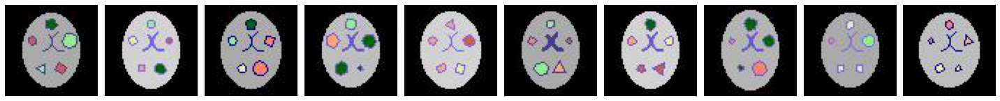

[2, 7, 10, 13, 15, 16, 17, 21, 25, 28]

GV : gen_brain_vol_1790.71-1947.79


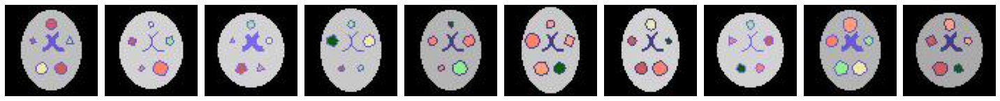

[11, 20, 23, 24, 29, 33, 45, 47, 49, 55]

GV : gen_brain_vol_1947.79-2104.87


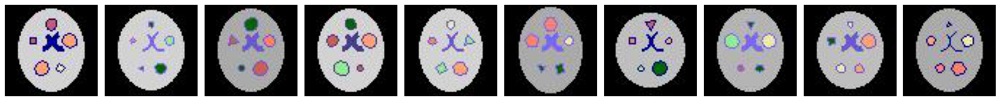

[0, 1, 3, 4, 5, 6, 8, 9, 14, 26]

GV : gen_brain_vol_2104.87-2261.95


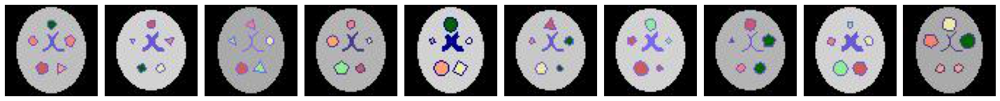

[12, 18, 19, 22, 30, 39, 41, 57, 58, 81]



In [43]:
show_examples(gens, col = 3, DIR = "toybrains", N = 10)

#### gen_shape-botl_curv

GV : gen_shape-botl_curv_4.0


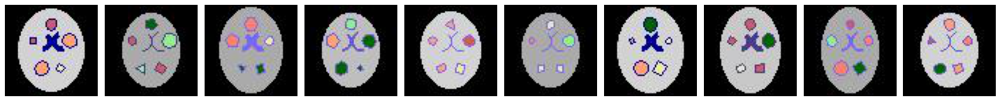

[0, 2, 6, 13, 15, 25, 30, 35, 62, 66]

GV : gen_shape-botl_curv_7.0


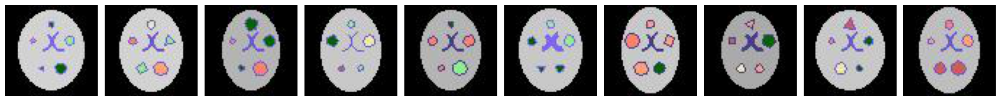

[1, 5, 21, 24, 29, 31, 33, 38, 39, 68]

GV : gen_shape-botl_curv_10.0


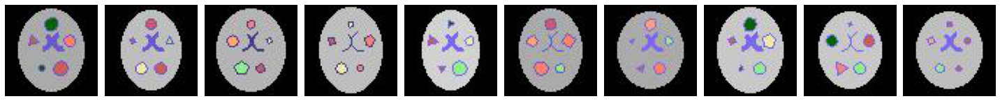

[3, 11, 22, 42, 46, 65, 69, 88, 107, 116]

GV : gen_shape-botl_curv_8.0


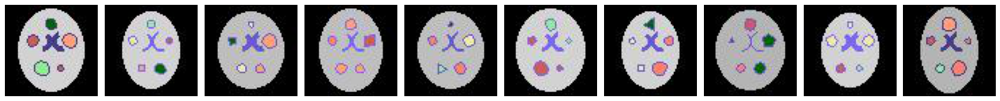

[4, 7, 14, 34, 36, 41, 51, 57, 76, 77]

GV : gen_shape-botl_curv_9.0


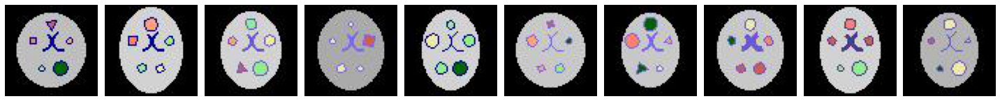

[8, 27, 32, 40, 44, 48, 64, 79, 90, 103]

GV : gen_shape-botl_curv_5.0


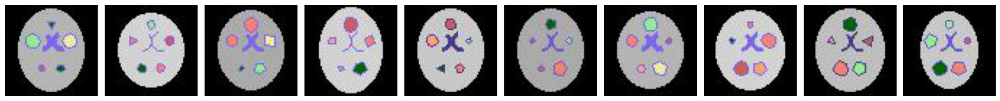

[9, 47, 50, 52, 53, 63, 67, 82, 93, 98]

GV : gen_shape-botl_curv_11.0


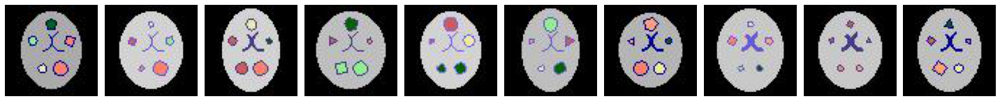

[10, 20, 45, 56, 59, 60, 61, 72, 74, 80]

GV : gen_shape-botl_curv_3.0


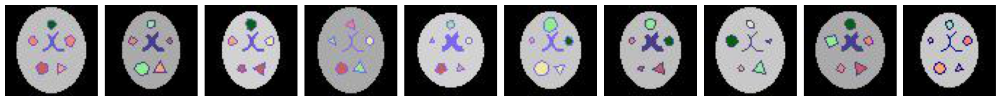

[12, 16, 17, 19, 23, 43, 85, 97, 99, 102]

GV : gen_shape-botl_curv_6.0


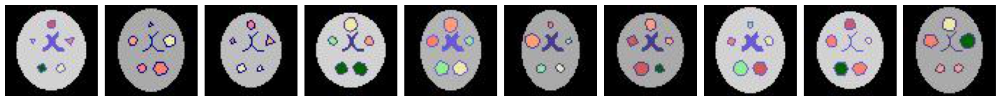

[18, 26, 28, 37, 49, 54, 55, 58, 73, 81]



In [44]:
show_examples(gens, col = 4, DIR = "toybrains", N = 10)

#### gen_shape-botl_int

GV : gen_shape-botl_int_palegoldenrod


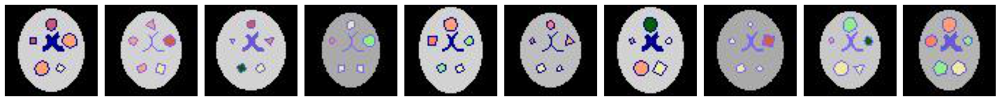

[0, 15, 18, 25, 27, 28, 30, 40, 43, 49]

GV : gen_shape-botl_int_darkgreen


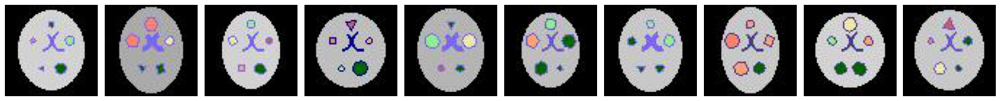

[1, 6, 7, 8, 9, 13, 31, 33, 37, 39]

GV : gen_shape-botl_int_indianred


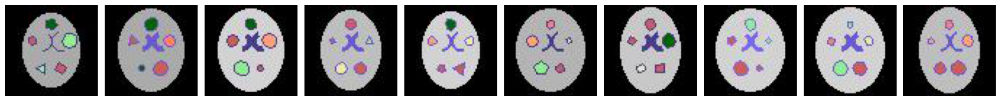

[2, 3, 4, 11, 17, 22, 35, 41, 58, 68]

GV : gen_shape-botl_int_lightsalmon


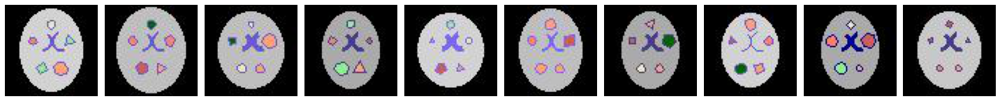

[5, 12, 14, 16, 23, 34, 38, 66, 70, 74]

GV : gen_shape-botl_int_salmon


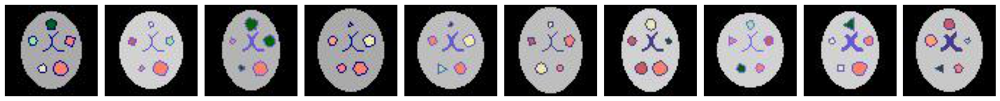

[10, 20, 21, 26, 36, 42, 45, 47, 51, 53]

GV : gen_shape-botl_int_lightgreen


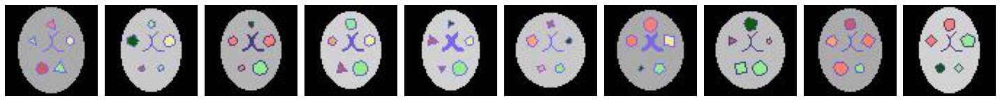

[19, 24, 29, 32, 46, 48, 50, 56, 65, 71]



In [45]:
show_examples(gens, col = 5, DIR = "toybrains", N = 10)

#### gen_shape-botl_vol

GV : gen_shape-botl_vol_10.39-27.16


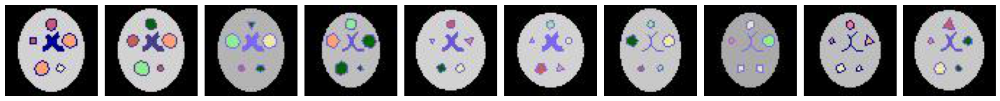

[0, 4, 9, 13, 18, 23, 24, 25, 28, 39]

GV : gen_shape-botl_vol_27.16-43.93


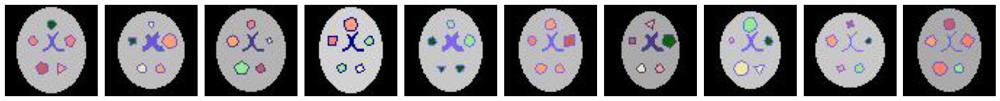

[12, 14, 22, 27, 31, 34, 38, 43, 48, 65]

GV : gen_shape-botl_vol_43.93-60.71


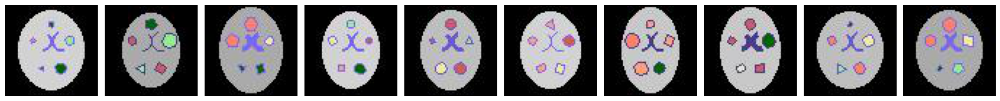

[1, 2, 6, 7, 11, 15, 33, 35, 36, 50]

GV : gen_shape-botl_vol_60.71-77.48


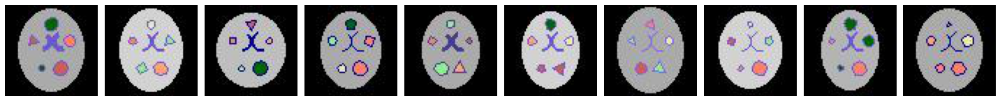

[3, 5, 8, 10, 16, 17, 19, 20, 21, 26]



In [46]:
show_examples(gens, col = 6, DIR = "toybrains", N = 10)

#### gen_shape-botr_curv

GV : gen_shape-botr_curv_8.0


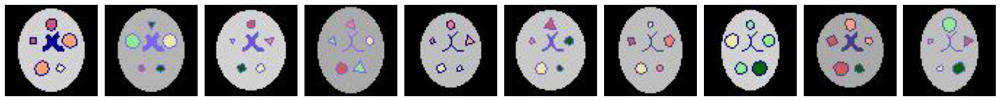

[0, 9, 18, 19, 28, 39, 42, 44, 55, 60]

GV : gen_shape-botr_curv_3.0


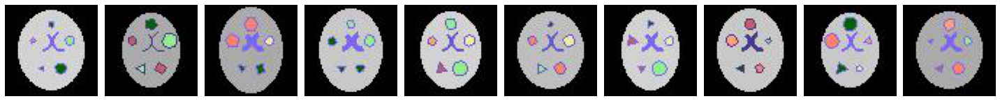

[1, 2, 6, 31, 32, 36, 46, 53, 64, 69]

GV : gen_shape-botr_curv_9.0


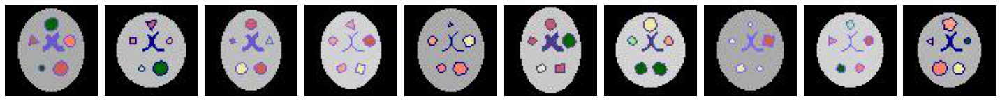

[3, 8, 11, 15, 26, 35, 37, 40, 47, 61]

GV : gen_shape-botr_curv_11.0


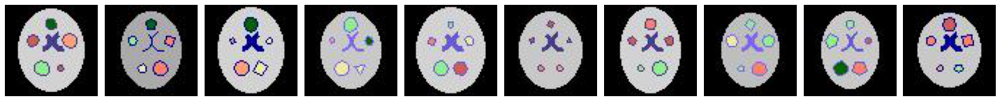

[4, 10, 30, 43, 58, 74, 90, 92, 98, 114]

GV : gen_shape-botr_curv_4.0


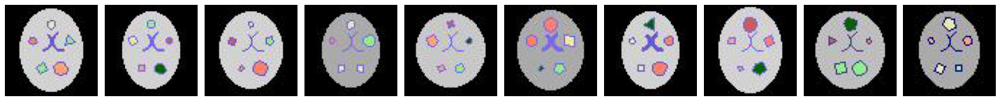

[5, 7, 20, 25, 48, 50, 51, 52, 56, 75]

GV : gen_shape-botr_curv_10.0


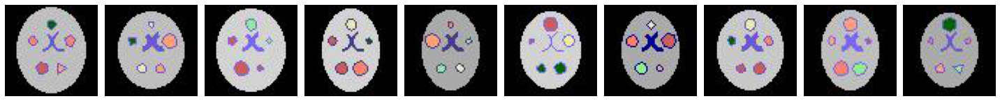

[12, 14, 41, 45, 54, 59, 70, 79, 83, 112]

GV : gen_shape-botr_curv_6.0


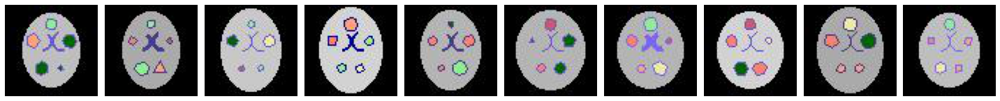

[13, 16, 24, 27, 29, 57, 67, 73, 81, 86]

GV : gen_shape-botr_curv_5.0


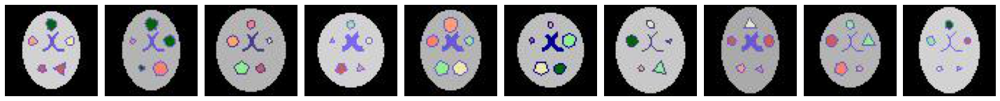

[17, 21, 22, 23, 49, 89, 97, 110, 115, 130]

GV : gen_shape-botr_curv_7.0


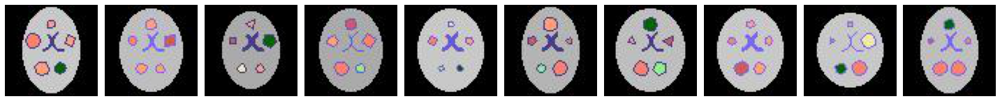

[33, 34, 38, 65, 72, 77, 93, 104, 109, 119]



In [47]:
show_examples(gens, col = 7, DIR = "toybrains", N = 10)

#### gen_shape-botr_int

GV : gen_shape-botr_int_lightsalmon


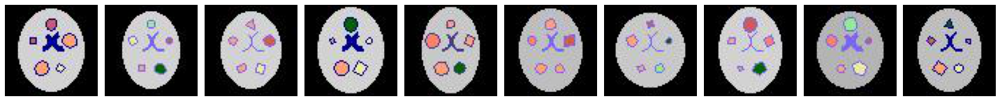

[0, 7, 15, 30, 33, 34, 48, 52, 67, 80]

GV : gen_shape-botr_int_darkgreen


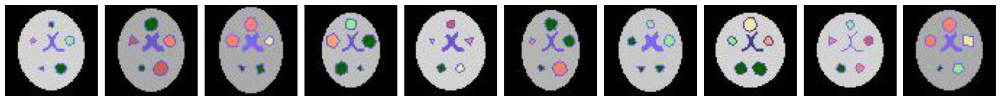

[1, 3, 6, 13, 18, 21, 31, 37, 47, 50]

GV : gen_shape-botr_int_lightgreen


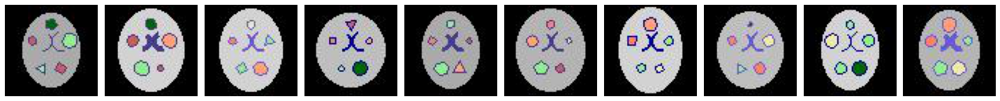

[2, 4, 5, 8, 16, 22, 27, 36, 44, 49]

GV : gen_shape-botr_int_indianred


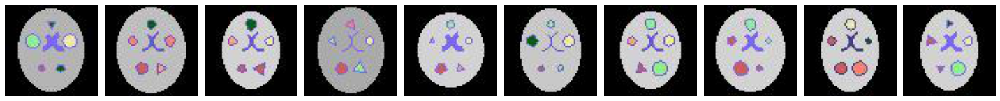

[9, 12, 17, 19, 23, 24, 32, 41, 45, 46]

GV : gen_shape-botr_int_palegoldenrod


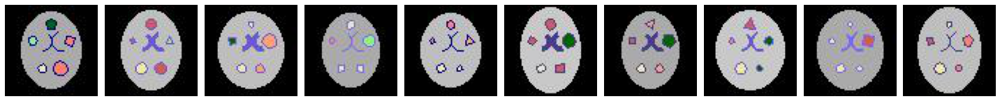

[10, 11, 14, 25, 28, 35, 38, 39, 40, 42]

GV : gen_shape-botr_int_salmon


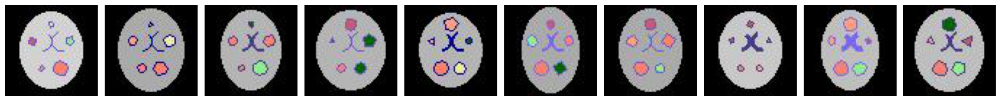

[20, 26, 29, 57, 61, 62, 65, 74, 83, 93]



In [48]:
show_examples(gens, col = 8, DIR = "toybrains", N = 10)

#### gen_shape-botr_vol

GV : gen_shape-botr_vol_10.39-27.16


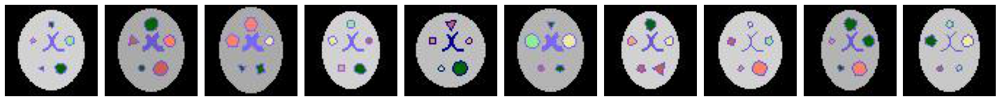

[1, 3, 6, 7, 8, 9, 17, 20, 21, 24]

GV : gen_shape-botr_vol_27.16-43.93


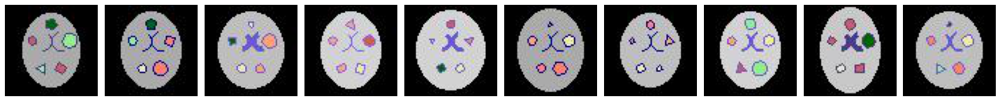

[2, 10, 14, 15, 18, 26, 28, 32, 35, 36]

GV : gen_shape-botr_vol_43.93-60.71


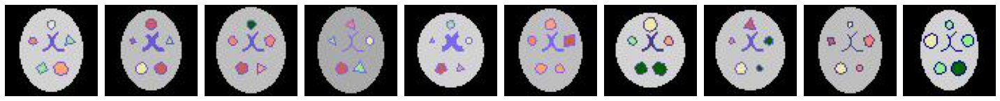

[5, 11, 12, 19, 23, 34, 37, 39, 42, 44]

GV : gen_shape-botr_vol_60.71-77.48


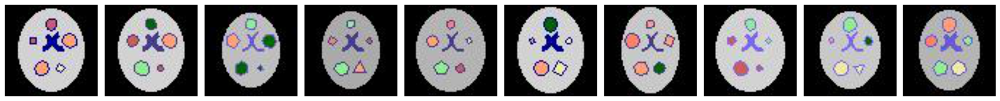

[0, 4, 13, 16, 22, 30, 33, 41, 43, 49]



In [49]:
show_examples(gens, col = 9, DIR = "toybrains", N = 10)

#### gen_shape-midl_curv

GV : gen_shape-midl_curv_4.0


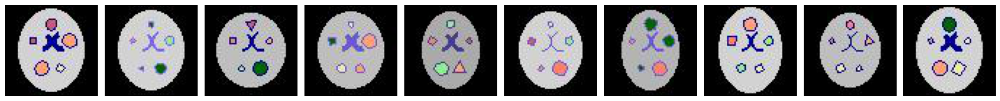

[0, 1, 8, 14, 16, 20, 21, 27, 28, 30]

GV : gen_shape-midl_curv_6.0


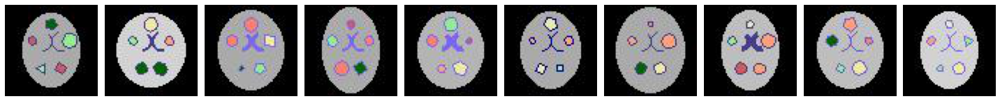

[2, 37, 50, 62, 67, 75, 105, 106, 108, 118]

GV : gen_shape-midl_curv_3.0


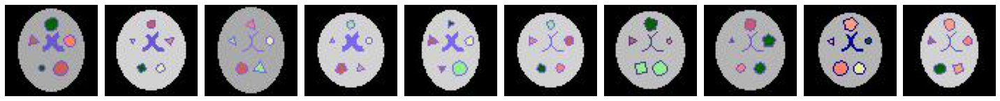

[3, 18, 19, 23, 46, 47, 56, 57, 61, 66]

GV : gen_shape-midl_curv_8.0


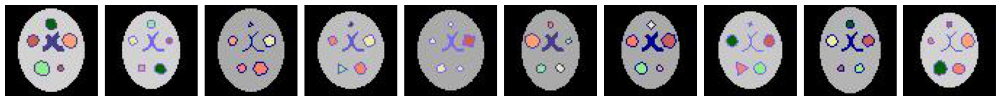

[4, 7, 26, 36, 40, 54, 70, 107, 120, 135]

GV : gen_shape-midl_curv_5.0


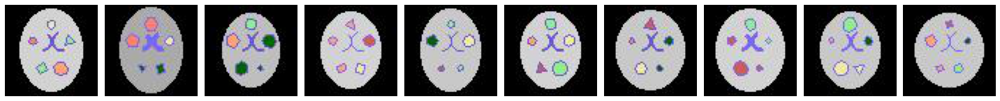

[5, 6, 13, 15, 24, 32, 39, 41, 43, 48]

GV : gen_shape-midl_curv_11.0


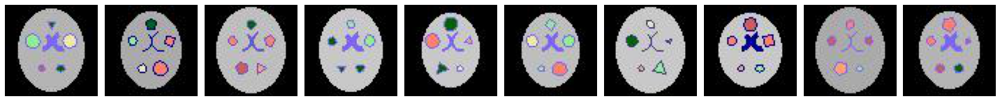

[9, 10, 12, 31, 64, 92, 97, 114, 163, 170]

GV : gen_shape-midl_curv_7.0


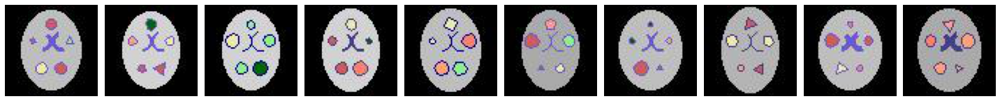

[11, 17, 44, 45, 100, 117, 127, 136, 139, 148]

GV : gen_shape-midl_curv_9.0


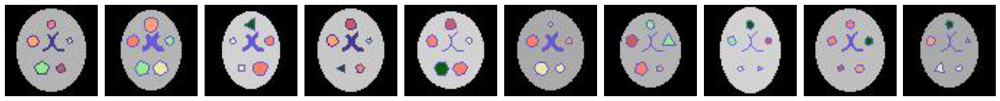

[22, 49, 51, 53, 73, 96, 115, 130, 133, 145]

GV : gen_shape-midl_curv_10.0


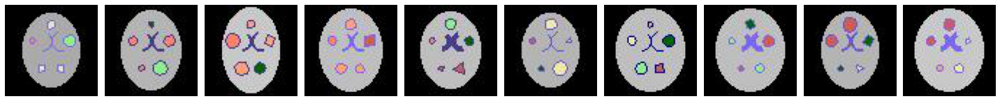

[25, 29, 33, 34, 85, 103, 125, 160, 165, 176]



In [50]:
show_examples(gens, col = 10, DIR = "toybrains", N = 10)

#### gen_shape-midl_int

GV : gen_shape-midl_int_indianred


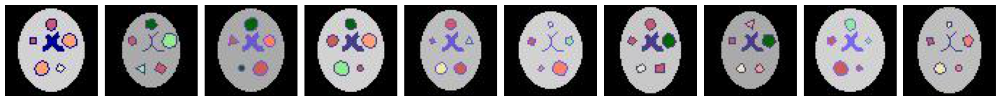

[0, 2, 3, 4, 11, 20, 35, 38, 41, 42]

GV : gen_shape-midl_int_salmon


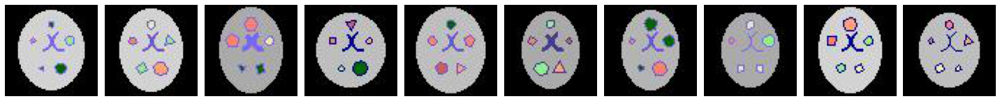

[1, 5, 6, 8, 12, 16, 21, 25, 27, 28]

GV : gen_shape-midl_int_palegoldenrod


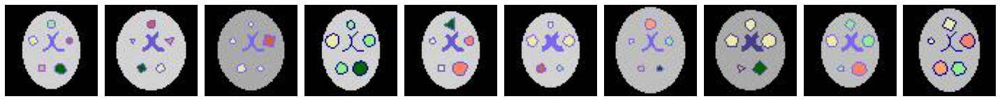

[7, 18, 40, 44, 51, 76, 87, 91, 92, 100]

GV : gen_shape-midl_int_lightgreen


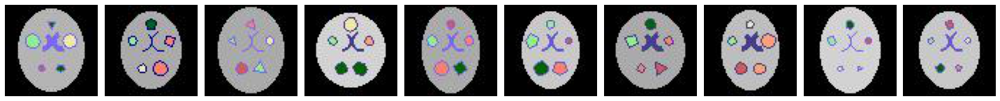

[9, 10, 19, 37, 62, 98, 99, 106, 130, 132]

GV : gen_shape-midl_int_lightsalmon


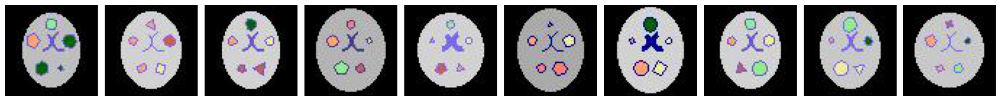

[13, 15, 17, 22, 23, 26, 30, 32, 43, 48]

GV : gen_shape-midl_int_darkgreen


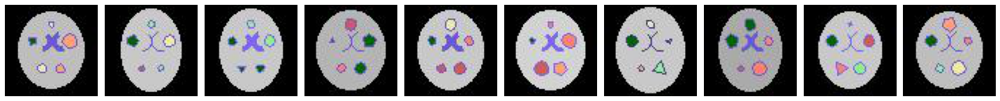

[14, 24, 31, 57, 79, 82, 97, 101, 107, 108]



In [51]:
show_examples(gens, col = 11, DIR = "toybrains", N = 10)

#### gen_shape-midl_vol

GV : gen_shape-midl_vol_10.39-27.16


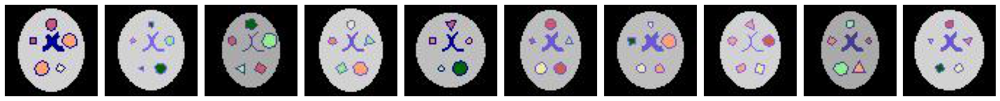

[0, 1, 2, 5, 8, 11, 14, 15, 16, 18]

GV : gen_shape-midl_vol_27.16-43.93


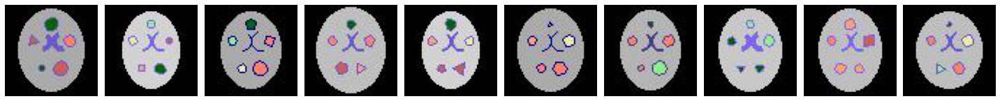

[3, 7, 10, 12, 17, 26, 29, 31, 34, 36]

GV : gen_shape-midl_vol_43.93-60.71


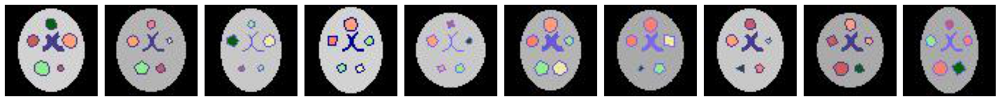

[4, 22, 24, 27, 48, 49, 50, 53, 55, 62]

GV : gen_shape-midl_vol_60.71-77.48


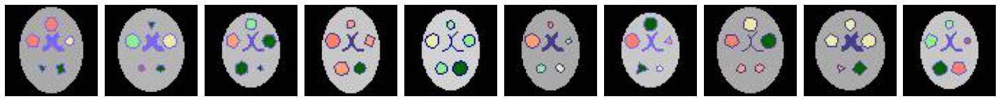

[6, 9, 13, 33, 44, 54, 64, 81, 91, 98]



In [52]:
show_examples(gens, col = 12, DIR = "toybrains", N = 10)

#### gen_shape-midr_curv

GV : gen_shape-midr_curv_8.0


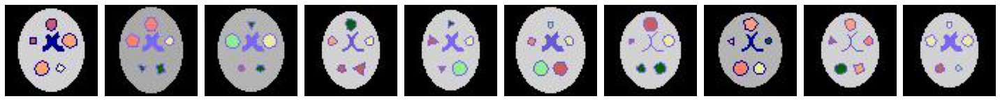

[0, 6, 9, 17, 46, 58, 59, 61, 66, 76]

GV : gen_shape-midr_curv_10.0


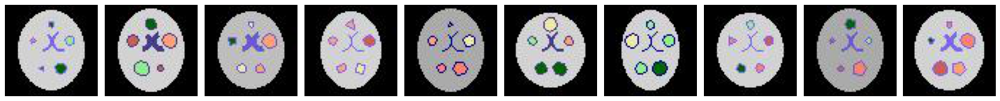

[1, 4, 14, 15, 26, 37, 44, 47, 63, 82]

GV : gen_shape-midr_curv_9.0


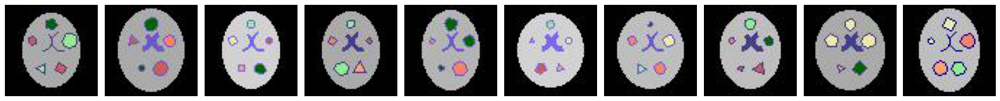

[2, 3, 7, 16, 21, 23, 36, 85, 91, 100]

GV : gen_shape-midr_curv_3.0


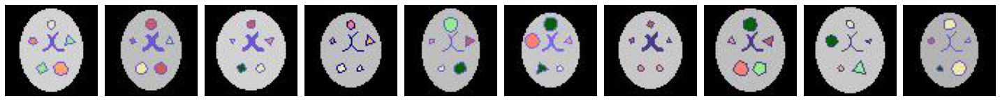

[5, 11, 18, 28, 60, 64, 74, 93, 97, 103]

GV : gen_shape-midr_curv_7.0


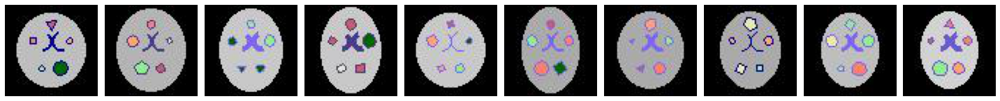

[8, 22, 31, 35, 48, 62, 69, 75, 92, 94]

GV : gen_shape-midr_curv_4.0


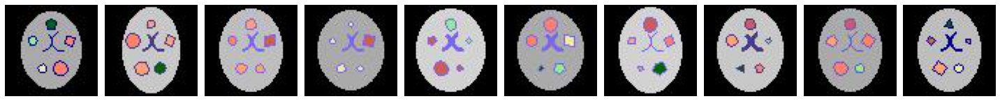

[10, 33, 34, 40, 41, 50, 52, 53, 65, 80]

GV : gen_shape-midr_curv_5.0


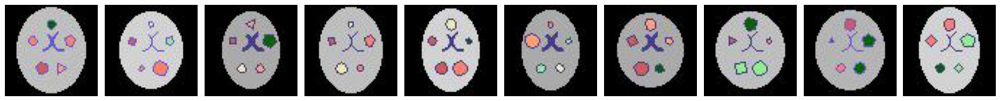

[12, 20, 38, 42, 45, 54, 55, 56, 57, 71]

GV : gen_shape-midr_curv_6.0


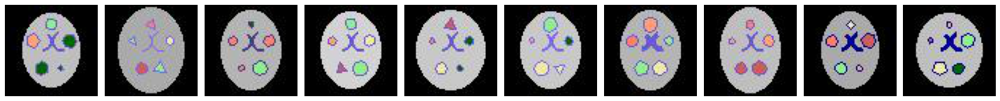

[13, 19, 29, 32, 39, 43, 49, 68, 70, 89]

GV : gen_shape-midr_curv_11.0


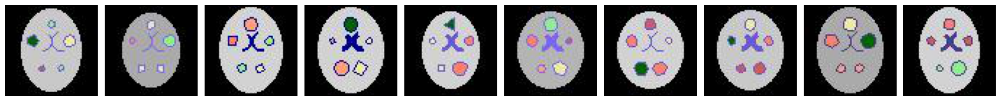

[24, 25, 27, 30, 51, 67, 73, 79, 81, 90]



In [53]:
show_examples(gens, col = 13, DIR = "toybrains", N = 10)

#### gen_shape-midr_int

GV : gen_shape-midr_int_lightsalmon


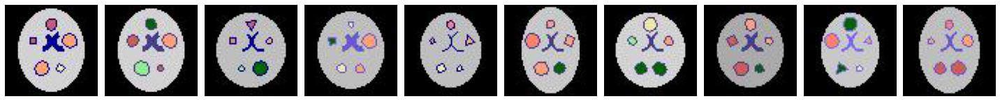

[0, 4, 8, 14, 28, 33, 37, 55, 64, 68]

GV : gen_shape-midr_int_lightgreen


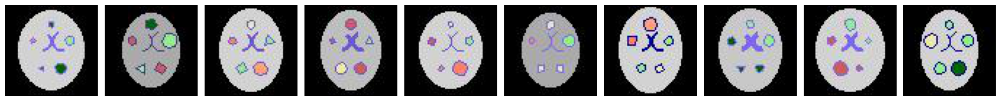

[1, 2, 5, 11, 20, 25, 27, 31, 41, 44]

GV : gen_shape-midr_int_salmon


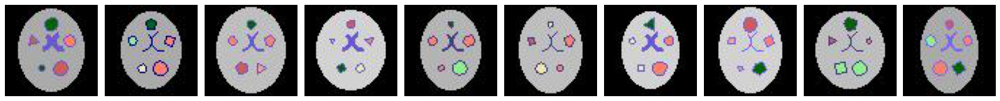

[3, 10, 12, 18, 29, 42, 51, 52, 56, 62]

GV : gen_shape-midr_int_palegoldenrod


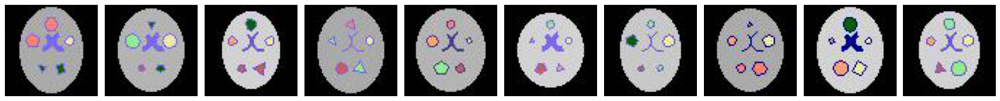

[6, 9, 17, 19, 22, 23, 24, 26, 30, 32]

GV : gen_shape-midr_int_indianred


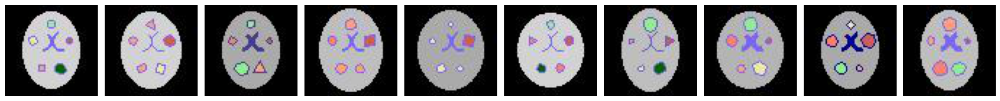

[7, 15, 16, 34, 40, 47, 60, 67, 70, 83]

GV : gen_shape-midr_int_darkgreen


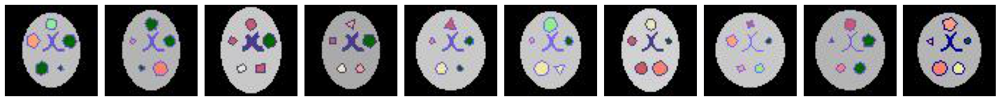

[13, 21, 35, 38, 39, 43, 45, 48, 57, 61]



In [54]:
show_examples(gens, col = 14, DIR = "toybrains", N = 10)

#### gen_shape-midr_vol

GV : gen_shape-midr_vol_10.39-27.16


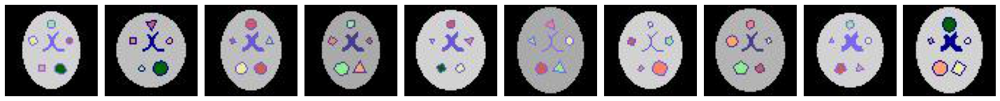

[7, 8, 11, 16, 18, 19, 20, 22, 23, 30]

GV : gen_shape-midr_vol_27.16-43.93


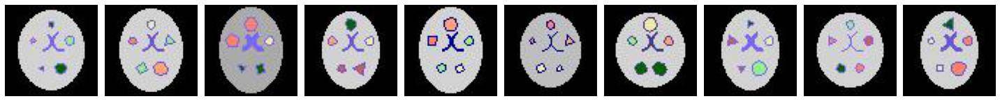

[1, 5, 6, 17, 27, 28, 37, 46, 47, 51]

GV : gen_shape-midr_vol_43.93-60.71


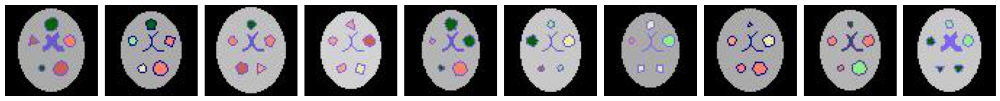

[3, 10, 12, 15, 21, 24, 25, 26, 29, 31]

GV : gen_shape-midr_vol_60.71-77.48


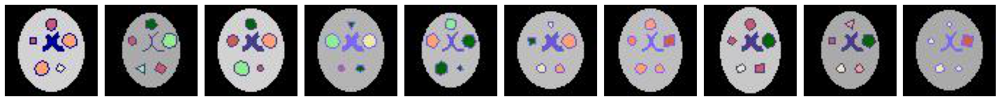

[0, 2, 4, 9, 13, 14, 34, 35, 38, 40]



In [55]:
show_examples(gens, col = 15, DIR = "toybrains", N = 10)

#### gen_shape-top_curv

GV : gen_shape-top_curv_9.0


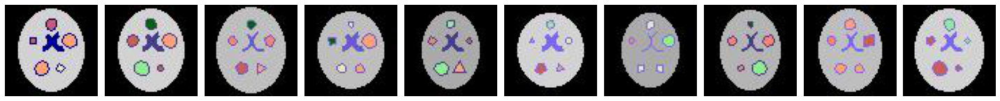

[0, 4, 12, 14, 16, 23, 25, 29, 34, 41]

GV : gen_shape-top_curv_11.0


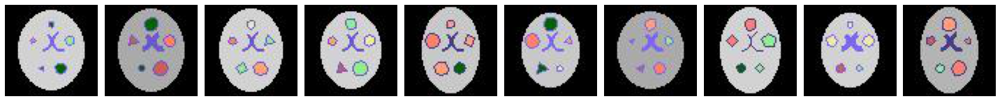

[1, 3, 5, 32, 33, 64, 69, 71, 76, 77]

GV : gen_shape-top_curv_5.0


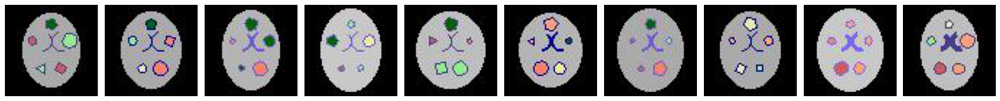

[2, 10, 21, 24, 56, 61, 63, 75, 104, 106]

GV : gen_shape-top_curv_6.0


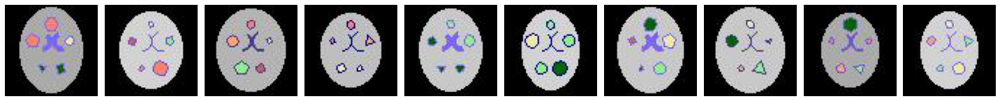

[6, 20, 22, 28, 31, 44, 88, 97, 112, 118]

GV : gen_shape-top_curv_8.0


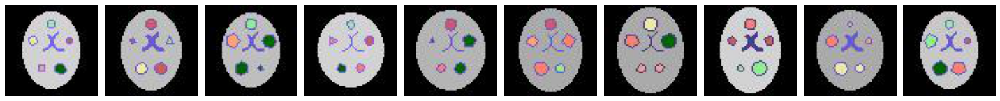

[7, 11, 13, 47, 57, 65, 81, 90, 96, 98]

GV : gen_shape-top_curv_3.0


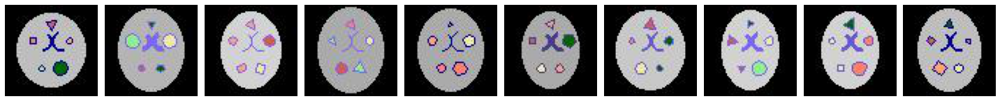

[8, 9, 15, 19, 26, 38, 39, 46, 51, 80]

GV : gen_shape-top_curv_7.0


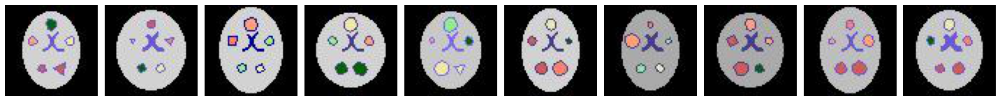

[17, 18, 27, 37, 43, 45, 54, 55, 68, 79]

GV : gen_shape-top_curv_10.0


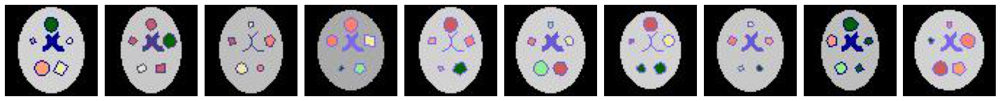

[30, 35, 42, 50, 52, 58, 59, 72, 78, 82]

GV : gen_shape-top_curv_4.0


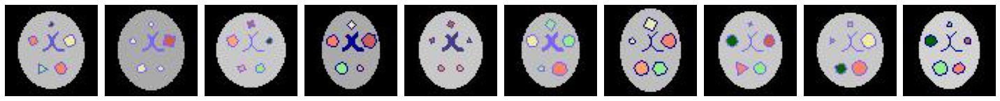

[36, 40, 48, 70, 74, 92, 100, 107, 109, 140]



In [56]:
show_examples(gens, col = 16, DIR = "toybrains", N = 10)

#### gen_shape-top_int

GV : gen_shape-top_int_indianred


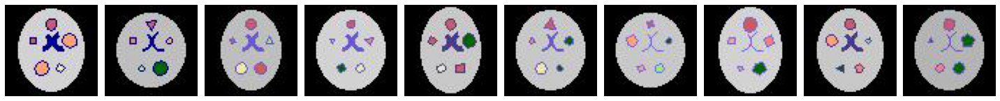

[0, 8, 11, 18, 35, 39, 48, 52, 53, 57]

GV : gen_shape-top_int_darkgreen


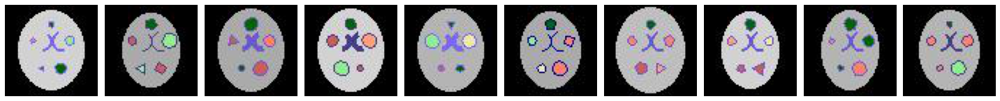

[1, 2, 3, 4, 9, 10, 12, 17, 21, 29]

GV : gen_shape-top_int_palegoldenrod


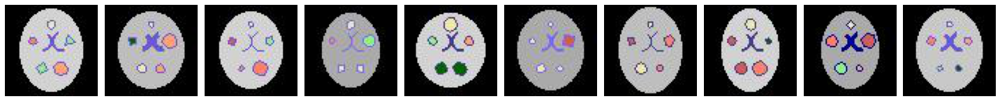

[5, 14, 20, 25, 37, 40, 42, 45, 70, 72]

GV : gen_shape-top_int_salmon


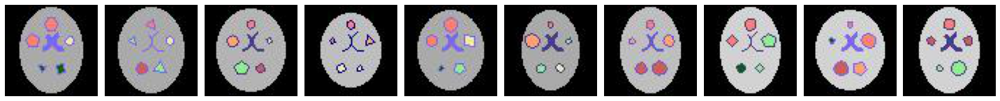

[6, 19, 22, 28, 50, 54, 68, 71, 82, 90]

GV : gen_shape-top_int_lightgreen


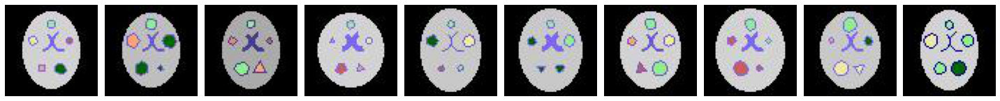

[7, 13, 16, 23, 24, 31, 32, 41, 43, 44]

GV : gen_shape-top_int_lightsalmon


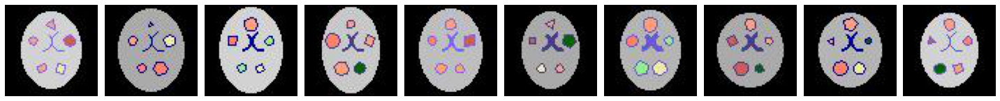

[15, 26, 27, 33, 34, 38, 49, 55, 61, 66]



In [57]:
show_examples(gens, col = 17, DIR = "toybrains", N = 10)

#### gen_shape-top_vol

GV : gen_shape-top_vol_10.39-27.16


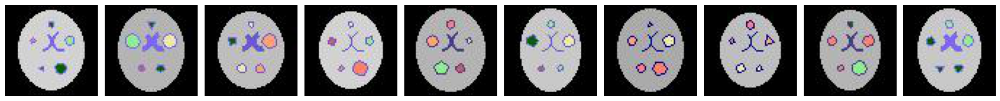

[1, 9, 14, 20, 22, 24, 26, 28, 29, 31]

GV : gen_shape-top_vol_27.16-43.93


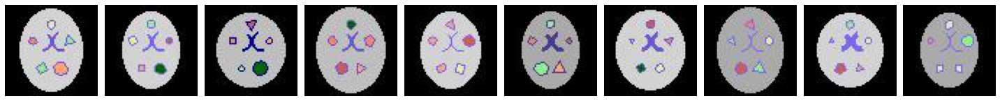

[5, 7, 8, 12, 15, 16, 18, 19, 23, 25]

GV : gen_shape-top_vol_43.93-60.71


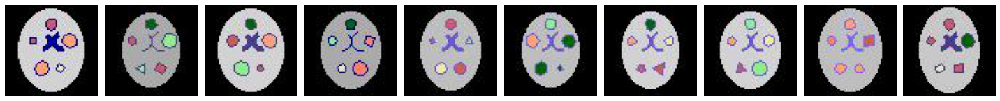

[0, 2, 4, 10, 11, 13, 17, 32, 34, 35]

GV : gen_shape-top_vol_60.71-77.48


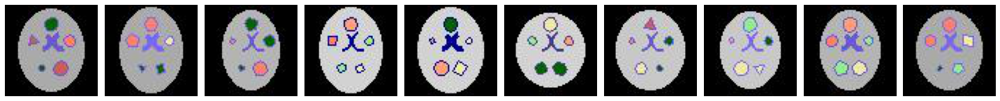

[3, 6, 21, 27, 30, 37, 39, 43, 49, 50]



In [58]:
show_examples(gens, col = 18, DIR = "toybrains", N = 10)

#### gen_vent_thick

GV : gen_vent_thick_4.0


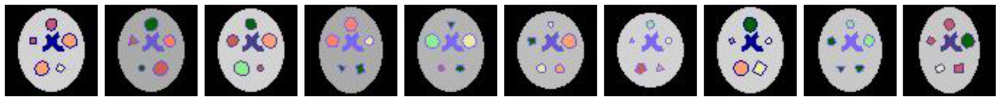

[0, 3, 4, 6, 9, 14, 23, 30, 31, 35]

GV : gen_vent_thick_2.0


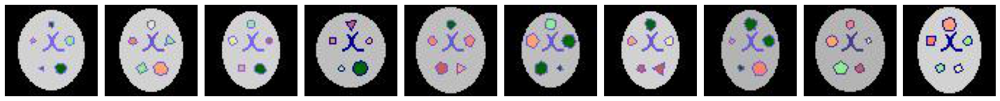

[1, 5, 7, 8, 12, 13, 17, 21, 22, 27]

GV : gen_vent_thick_1.0


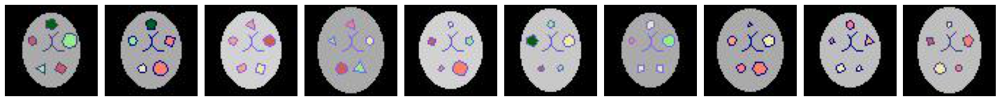

[2, 10, 15, 19, 20, 24, 25, 26, 28, 42]

GV : gen_vent_thick_3.0


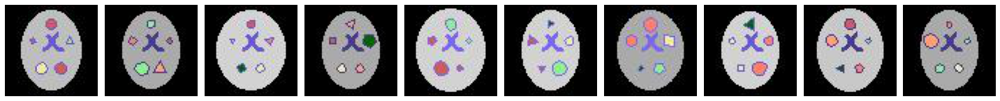

[11, 16, 18, 38, 41, 46, 50, 51, 53, 54]



In [59]:
show_examples(gens, col = 19, DIR = "toybrains", N = 10)

<div class="alert alert-block alert-success">
The content below is currently being written, so please do not refer to it.
</div>

## Comphresion of Covariates in Toy Brains Dataset

`TBA` (TODO) The section refactoring may needed

### Labels
1. purely based on 4 shapes (combinations that are linear and non-linear)
2. partially based on confounder + partially shapes : see the idea from MDN
3. purely based on confounder pathway
4. Create a brain_mask and save it as a label

### Confounds
1. `age ~ brain_vol & vent_thick` such that `up(age) -> up(vent_thick)` `up(age) -> down(brain_vol)`
2. `sex ~ brain_vol` as a intermediary causal variable such that `male ~ large(brain vol)` `female ~ small(brain vol)`
3. `site ~ outline_color & brain_int` such that 
4. Find citations for (2) and (3)
5. add lesions? 
6. ~add a shape {triangle, square, pentagon, hexagon, ..} at top bottom right and left~

LOGO
----
`TBA` (TODO) Generating Logo of Toy Brains Dataset

In [ ]:
S=200
# Create a new image with a black background
img = Image.new("RGB", (S, S), color="black")

# Draw two arcs at the center of the image, facing opposite to each other and touching at the center
draw = ImageDraw.Draw(img)
x_off, y_off= 0,0
xy_r = (S*.2, S*.2, S*.5, S*.5)
xy_l = (S*.5, S*.2, S*.8, S*.5)
print(xy_r, xy_l)
draw.arc(xy_r, start=300, end=100,   fill="red",  width=8)
draw.arc(xy_l, start=-300, end=-100, fill="blue", width=8)

# Show the image
img